note : write 'default' if you won't change default data file 
 Enter the file path: default
+--------------+------------------+
| Column Name  | Column Data Type |
+--------------+------------------+
|   data_dte   |      object      |
|     Year     |      int64       |
|    Month     |      int64       |
|  usg_apt_id  |      int64       |
|   usg_apt    |      object      |
|   usg_wac    |      int64       |
|  fg_apt_id   |      int64       |
|    fg_apt    |      object      |
|    fg_wac    |      int64       |
|  airlineid   |      int64       |
|   carrier    |      object      |
| carriergroup |      int64       |
|     type     |      object      |
|  Scheduled   |      int64       |
|   Charter    |      int64       |
|    Total     |      int64       |
+--------------+------------------+
          data_dte usg_apt fg_apt carrier        type
0       05/01/2006     GUM    MAJ     PFQ  Departures
1       05/01/2003     ANC    OKO      5Y  Departures
2       03/01/2007     BOS

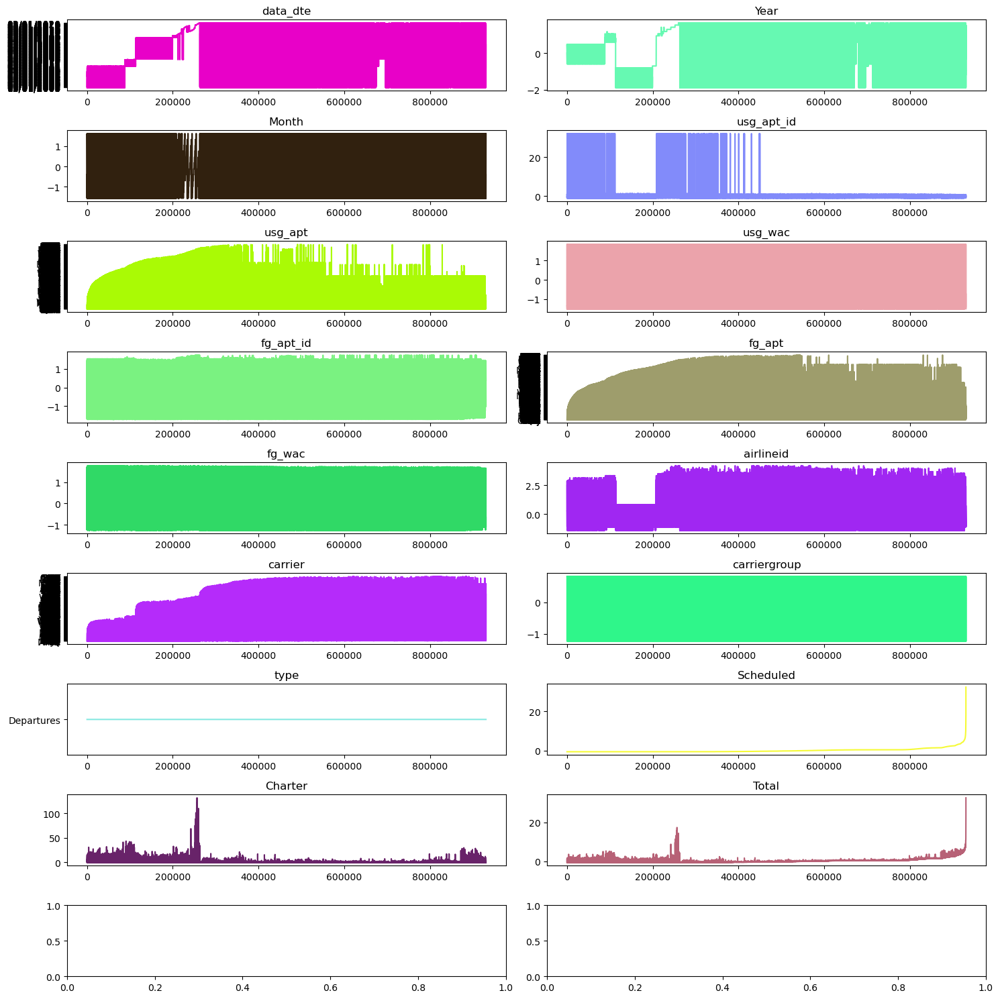




 Using matplotlib-histogram at numerical columns 


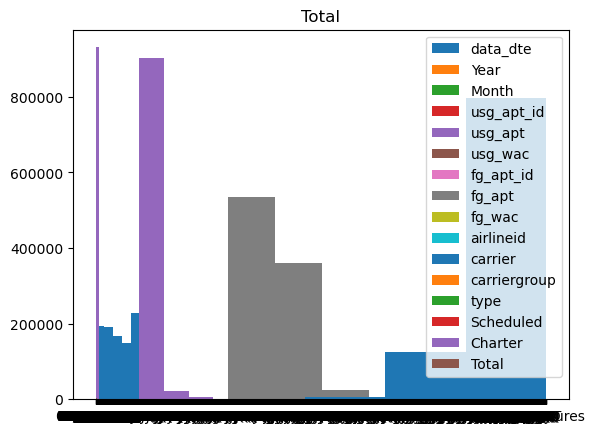




 Using matplotlib-pie at all columns 


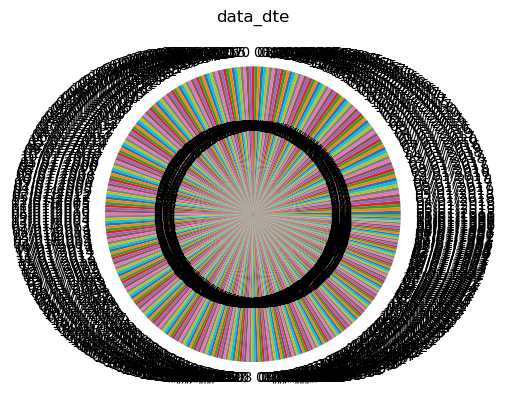

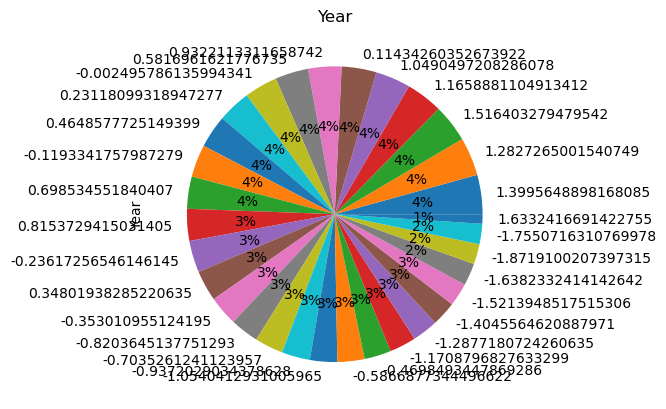

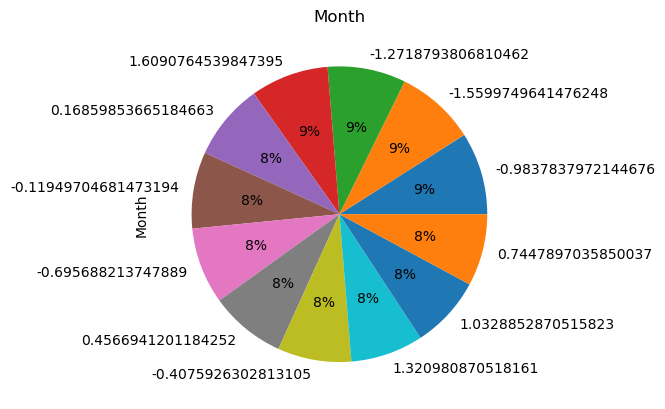

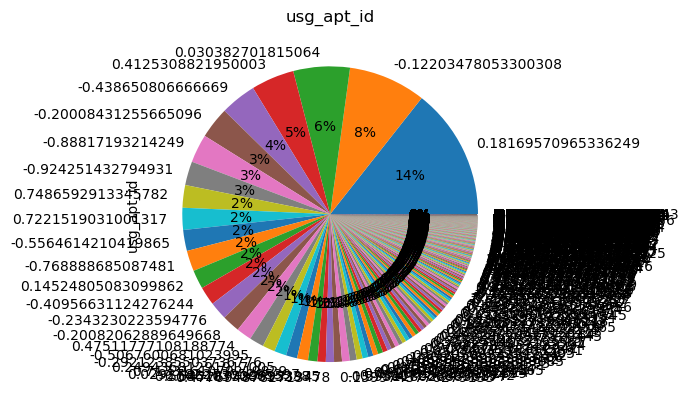

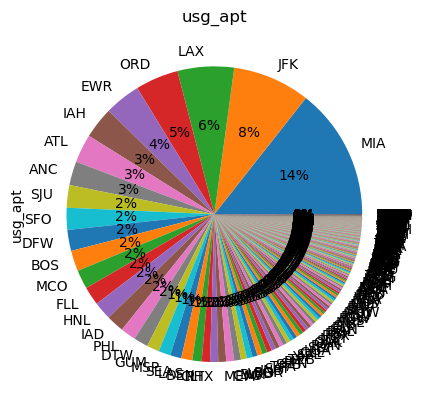

...

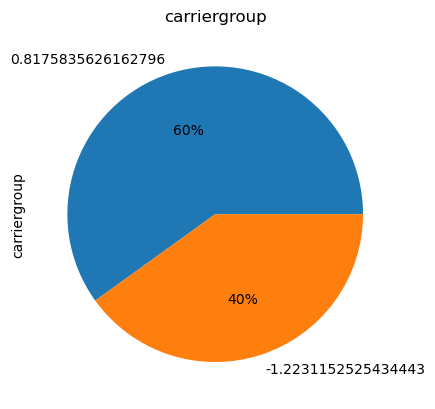

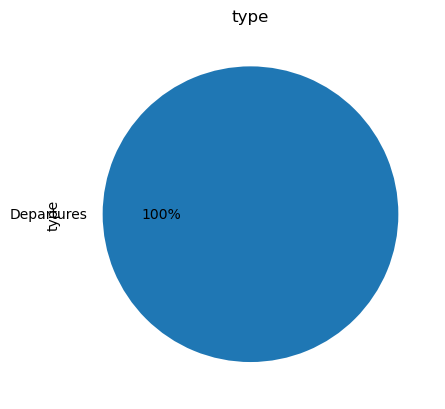

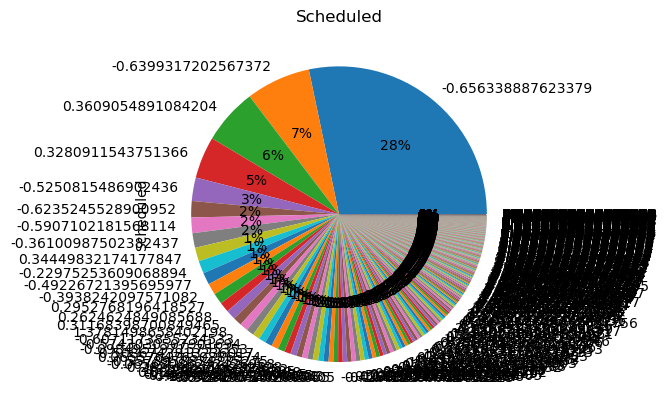

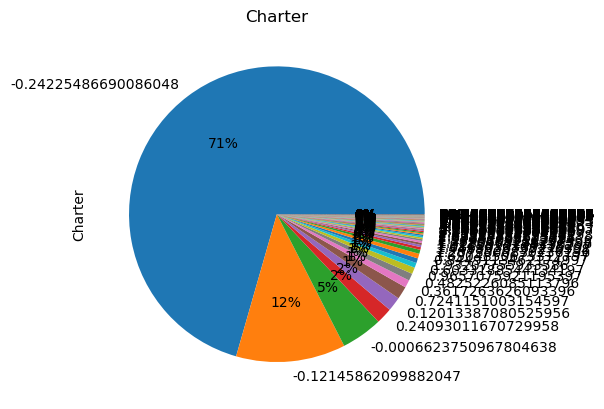

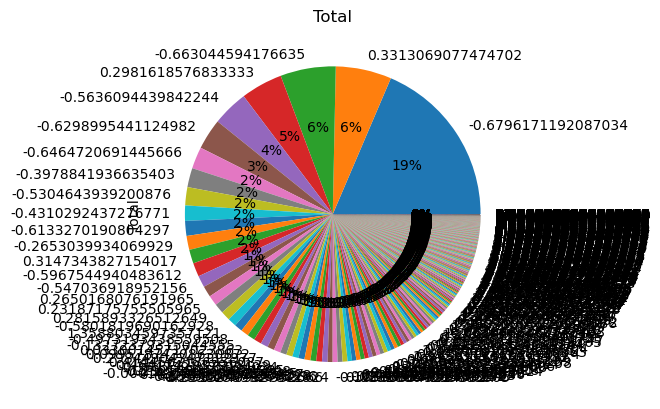




 Using matplotlib-scatter at all columns 


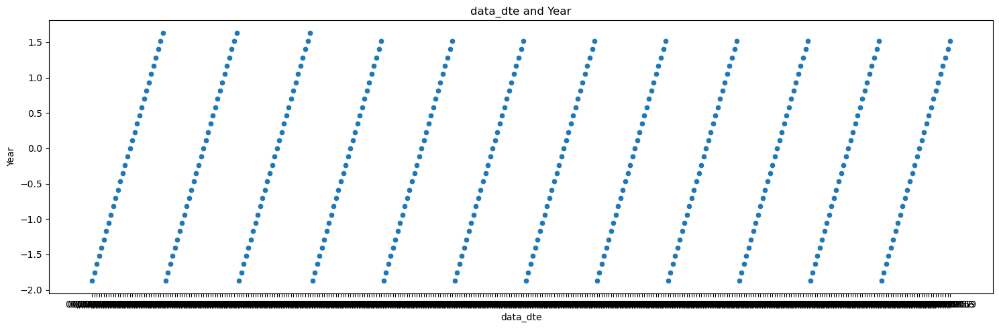

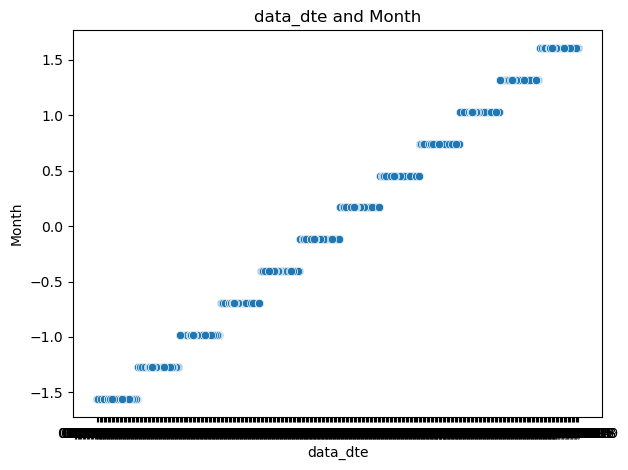

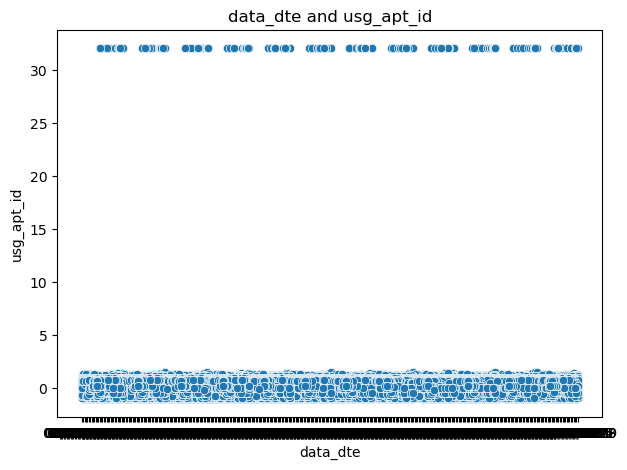

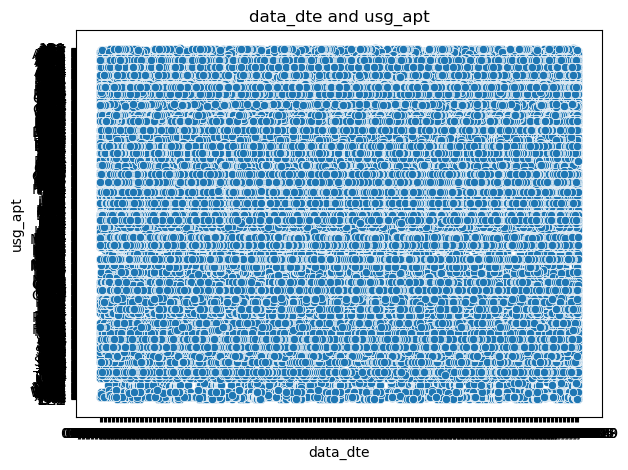

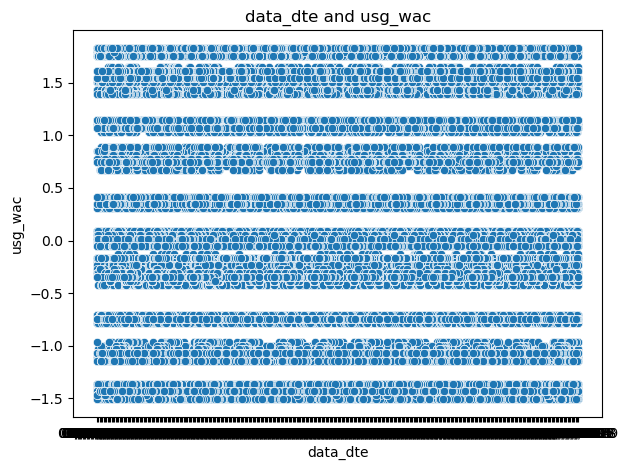

...

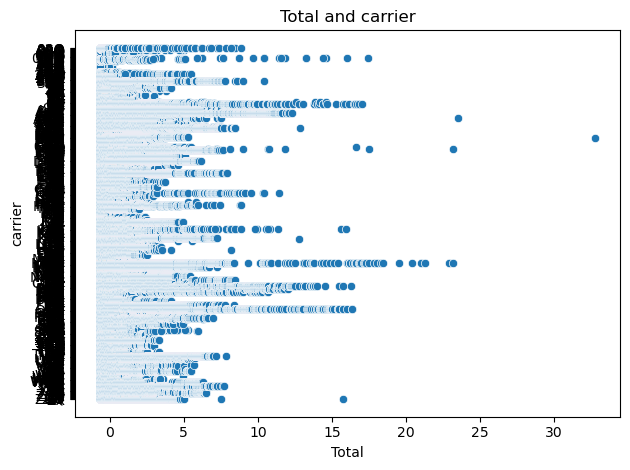

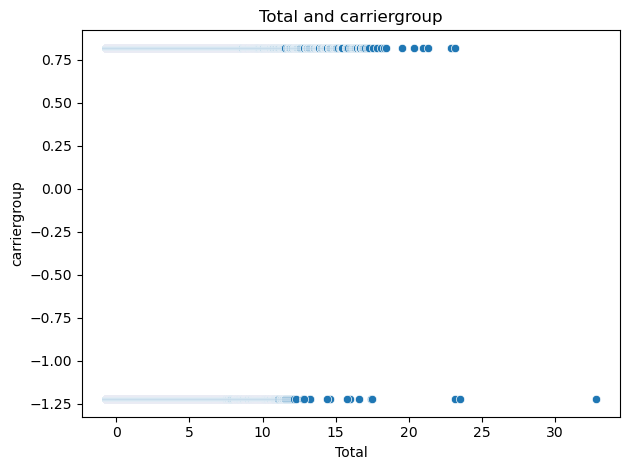

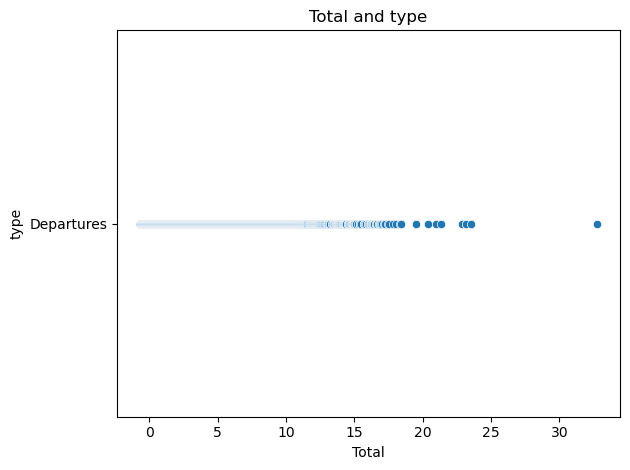

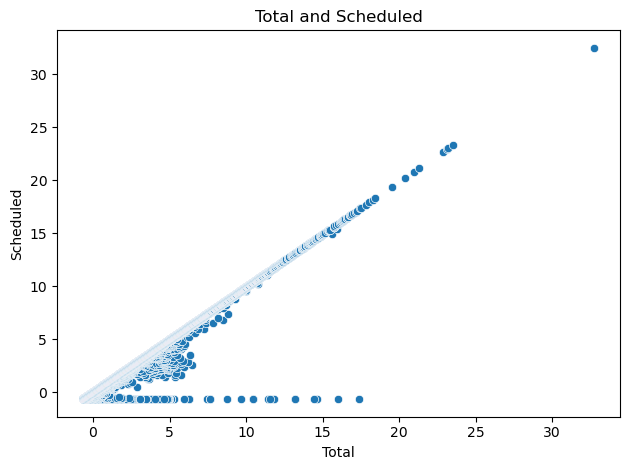

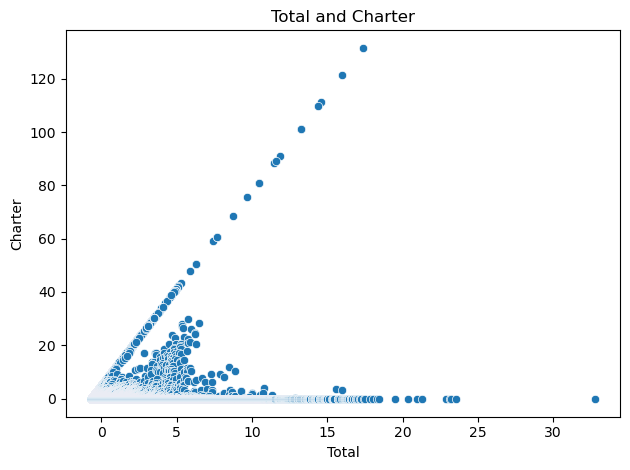

end visualization


In [5]:
import pandas as pd
import sqlite3        #we use it to build a connection with SQL file (as I think)
from texttable import Texttable
from prettytable import PrettyTable
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt2
import matplotlib.pyplot as plt3
import matplotlib.pyplot as plt4
import numpy as np
import seaborn as sns





#Read data in varios formats
def reading_data_func(path):
    if path=="default" :
        data=pd.read_csv('International_Report_Departures.csv')
    elif path.endswith('.csv'):
        data=pd.read_csv(path)
    elif path.endswith('xlsx'):
        data=pd.read_exel(path)
    elif path.endswith('.sqlite'):
        table_name=input("Enter table name")
        conn = sqlite3.connect(path)
        data = pd.read_sql('''SELECT * FROM '''+table_name,conn)
        
    else:
        print("This program accept only files that their extention .csv , .xlsx or .sqlite ")
        data=[]
    
    return data



#preprocessing the data 
def preprocessing_func(data):
    
    #identify the datatype of each column
    
    my_table =PrettyTable(["Column Name", "Column Data Type"]) 
    for column in data.columns:
        my_table.add_row([column, data[column].dtype])
    print(my_table)
    
    
    
    
    #performing appropriate pre-processing steps
    
    #there are many methods to deal with missimg values like:
    data.ffill(inplace=True) # replace Missing values using ffill
    #data.dropna(inplace=True)  #Drop rows with missing values
    #data.fillna(data.mean(), inplace=True) # fill with mean
    #data.fillna(data.median(), inplace=True) # fill with median
    #data.fillna(0, inplace=True) # fill with zero
    
    
    
    column_types = data.dtypes  
    
    # Encode categorical features
    categorical_columns = column_types[column_types == 'object'].index
    data[categorical_columns] = data[categorical_columns].astype('category')
    print(data[categorical_columns])
    
    # Scale numerical features
    numerical_columns = column_types[column_types != 'object'].index
    data[numerical_columns] = (data[numerical_columns] - data[numerical_columns].mean()) / data[numerical_columns].std()
    
    return data



#Generate comprehensive visualization dashboard
def auto_visualization_func():
    column_types = data.dtypes
    object_columns = column_types[column_types == 'object'].index
    numerical_columns = column_types[column_types != 'object'].index
    print("Numerical Columns are :")
    print(numerical_columns)
    print("Objective Columns are :")
    print(object_columns)
    
    
    
    
    
    
    
    print("\n\n\n Using matplotlib-plot at numerical columns")
    plot_row_num=int(len(numerical_columns)/2)
    fig,axis=plt.subplots(plot_row_num+1,2)
    row=0
    col=0
    for x in numerical_columns:
        if col==2:
            row=row+1
            col=0
        axis[row,col].plot(data[x],color=np.random.rand(3,))
        axis[row,col].set_title(x)
        col=col+1
        
        
    fig.set_figheight(15)
    fig.set_figwidth(15)
    fig.tight_layout()
    plt.show()
    
    
    
    print("\n\n\n Using matplotlib-histogram at numerical columns ")
    for column in numerical_columns:
        plt3.hist(data[column],bins=5,label=column)
        plt3.title(column)
    plt3.legend()
    plt3.show()
    
    
    
    
    print("\n\n\n Using matplotlib-pie at all columns ")
    for column in data.columns:
        data[column].value_counts().plot.pie(autopct='%1.0f%%')
        plt4.title(column)
        plt4.show()
        
    
   
    
    print("\n\n\n Using scatterplot at all columns ")
    
    plt2.figure(figsize=(15, 5))
    for x in data.columns:
        for y in data.columns:
            if x==y:
                continue
            sns.scatterplot(x=data[x],y=data[y])
            plt2.title(x+" and "+y)
            plt2.tight_layout()
            plt2.show()
            

            
            
            
def manual_visualization_func(f_col,s_col,plot_type):
    global data 
    
    plt.figure(figsize=(10,10))
    
    if plot_type == "horizontal_bar":
        plt.barh(data[f_col],data[s_col],color ='maroon')
        plt.xlabel(f_col)
        plt.ylabel(s_col)
        plt.title("horizontal_bar of "+ f_col +" and "+ s_col)
        plt.show()
        
    elif plot_type == "histogram":
        plt.hist(data[f_col],label=f_col)
        plt.hist(data[s_col],label=s_col)
        plt.title("Histogram of "+ f_col +" and "+ s_col)
        plt.legend()
        plt.tight_layout()
        plt.show()
        
    elif plot_type == "scatter":
        sns.scatterplot(x=data[f_col], y=data[s_col])
        plt.title("Scatter plot of "+ f_col +" and "+ s_col)
        plt.show()
    
    elif plot_type == "heatmap":
        heatmap_data = data.pivot_table(index=f_col, columns=s_col, values='Total', aggfunc='mean')
        sns.heatmap(heatmap_data, annot=True, cmap='coolwarm')
        plt.title("heatmap between "+ f_col +" and "+ s_col)
        plt.show()
    
    elif plot_type == "pie":
        data[f_col].value_counts().plot.pie(autopct='%1.0f%%')
        plt.title(f_col + "pie chart")
        
        
        data[s_col].value_counts().plot.pie(autopct='%1.0f%%')
        plt.title(s_col+" Pie Chart")
        plt.show()
    
    else:
        print("something went wrong")
            
            
    
 
    
    
#main

#using reading data function
data=pd.DataFrame({})
while len(data)==0 :
    print("note : write 'default' if you won't change default data file ")
    path = input(" Enter the file path: ")
    data = reading_data_func(path)
    
    
#using preprocessing function
data=preprocessing_func(data)



#visualization
vis_type=""
while True :
    vis_type=input("What kind of Visualization do you prefere ? (manual/auto)")
    if vis_type == "manual" or vis_type == "auto" :
        break
    else:
        print("invalid input . Please , enter 'manual' or 'auto'. ")

print("start visualization")

if vis_type=="auto":
    auto_visualization_func()
else:
    data_col_names=data.columns
    print(data.columns)
    while True:
        col1=input("enter the name of the first column")
        col2=input("enter the name of the first column")
        if col1 in data_col_names and col2 in data_col_names:
            break
        else:
            print("Enter valid one , This column you entered is not exist in your data frame")
    while True:
        vis_type=input("enter what kind of plot you wanna apply (horizontal_bar ,histogram, scatter, heatmap, pie):")
        if vis_type=="horizontal_bar" or vis_type=="histogram"  or vis_type=="scatter" or vis_type=="heatmap" or vis_type=="pie"  :
            break
        else:
            print("please , enter valid plot type")
    manual_visualization_func(col1,col2,vis_type)

print("end visualization")
    